In [1]:
import mlflow

mlflow.__version__

C:\Users\L14\anaconda3\lib\site-packages\pydantic\_internal\_fields.py:128: UserWarning: Field "model_server_url" has conflict with protected namespace "model_".

You may be able to resolve this warning by setting `model_config['protected_namespaces'] = ()`.
  warnings.warn(
C:\Users\L14\anaconda3\lib\site-packages\pydantic\_internal\_config.py:317: UserWarning: Valid config keys have changed in V2:
* 'schema_extra' has been renamed to 'json_schema_extra'
  warnings.warn(message, UserWarning)


'2.8.1'

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

### TODO Recording

- Open up https://openml.org/ and scroll and show the page
(Open ML can help you train models and run pipelines but we will only use the dataset)
- Search for housing and see that there are many datasets avaialable

### OpenML 

https://openml.org/

https://scikit-learn.org/stable/datasets/loading_other_datasets.html#openml

In [3]:
from sklearn.datasets import fetch_openml

house_price_df = fetch_openml(
    'house_sales', version = 1, as_frame = True, 
    return_X_y = False, parser = 'auto'
)

house_price_df.data.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [4]:
house_price_df.data.drop(columns = ['date', 'zipcode'], inplace = True)

house_price_df.data.sample(5)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15
15300,335000.0,3,2.50,1740,5267,2.0,0,0,3,7,1740,0,1999,0,47.3777,-122.023,2180,5000
6114,541125.0,5,2.75,2740,8426,1.0,0,0,4,8,1370,1370,1960,0,47.5563,-122.184,2020,8783
4961,525000.0,4,2.50,3070,7200,2.0,0,0,3,8,3070,0,2005,0,47.4899,-122.138,2590,7200
19511,487585.0,4,1.75,2010,9211,1.0,0,0,3,7,1470,540,1977,0,47.7206,-122.171,1840,8500
21519,420000.0,1,2.00,1070,675,2.0,0,0,3,8,880,190,2007,0,47.5574,-122.284,1220,788


In [5]:
house_price_df.data.shape

(21613, 18)

In [6]:
house_price_df.data = house_price_df.data.drop_duplicates()

house_price_df.data.shape

(21608, 18)

In [7]:
house_price_df.data['age'] = 2015 - house_price_df.data['yr_built']

# Will be 2015 (a large number) for homes that have never been renovated
house_price_df.data['renovation_age'] = 2015 - house_price_df.data['yr_renovated']

house_price_df.data.sample(5)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,age,renovation_age
10011,530000.0,2,1.75,2120,7680,1.0,0,0,5,6,1130,990,1948,0,47.5304,-122.374,1220,7680,67,2015
16720,2140000.0,6,4.00,5110,7128,2.5,0,0,4,11,5110,0,1906,0,47.6285,-122.304,4110,6480,109,2015
5143,754300.0,5,2.75,1800,4500,2.0,0,0,4,7,1680,120,1939,0,47.6648,-122.358,1730,4500,76,2015
10485,325000.0,2,1.00,1070,8750,1.0,0,0,3,7,1070,0,1951,0,47.4734,-122.198,1300,9670,64,2015
14729,620000.0,3,2.50,2480,9041,2.0,0,0,3,7,2480,0,2004,0,47.6797,-122.035,2480,6500,11,2015


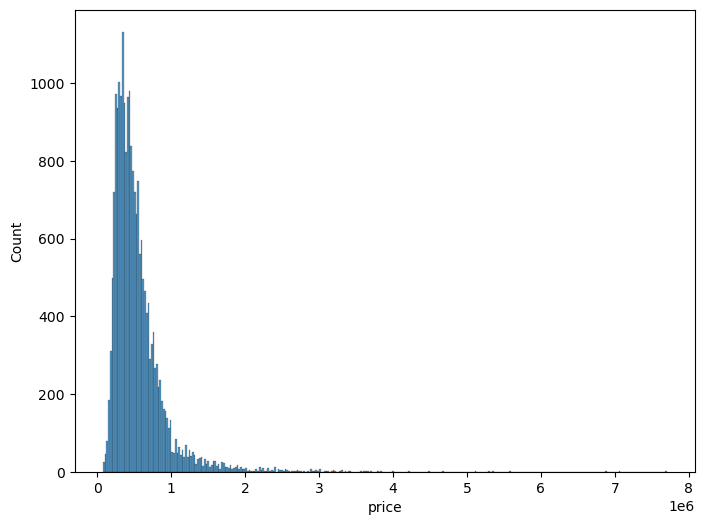

In [8]:
fig1, ax1 = plt.subplots(figsize = (8, 6))

sns.histplot(x = 'price', data = house_price_df.data)
plt.show()

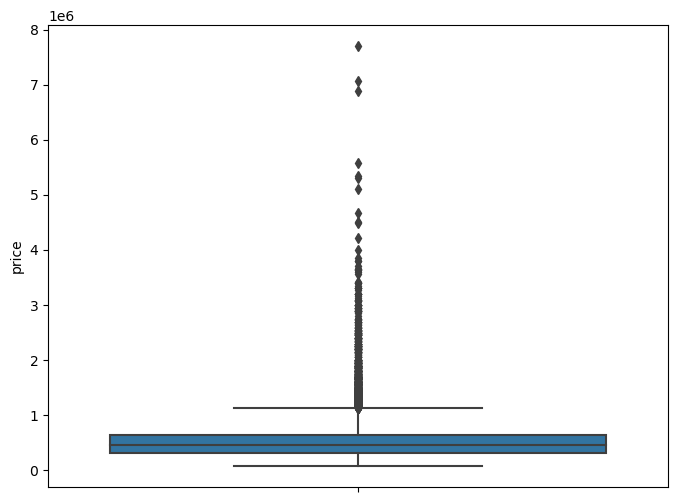

In [9]:
fig2, ax2 = plt.subplots(figsize = (8, 6))

sns.boxplot(y = 'price', data = house_price_df.data)
plt.show()

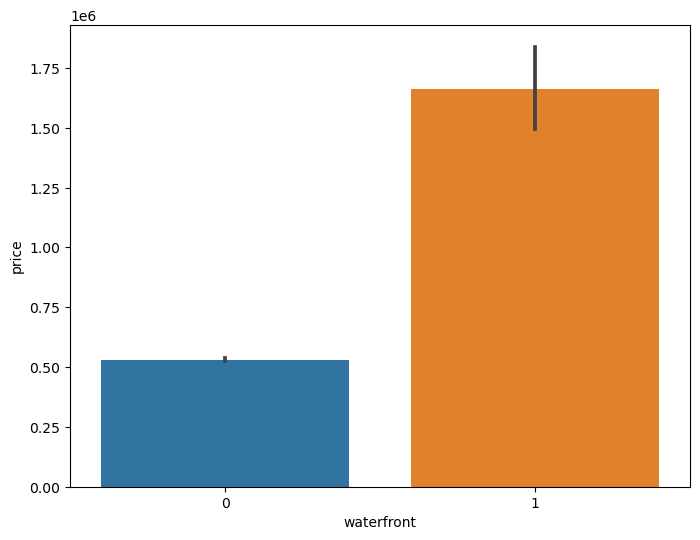

In [10]:
fig3, ax3 = plt.subplots(figsize = (8, 6))

sns.barplot(x = 'waterfront', y = 'price', data = house_price_df.data)
plt.show()

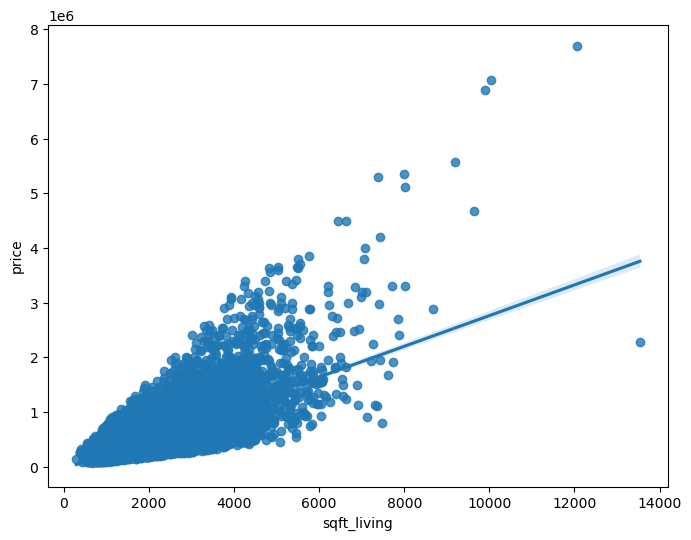

In [11]:
fig4, ax4 = plt.subplots(figsize = (8, 6))

sns.regplot(data = house_price_df.data, x = 'sqft_living', y = 'price')
plt.show()

#### Selecting a few features to keep heatmap easy to read

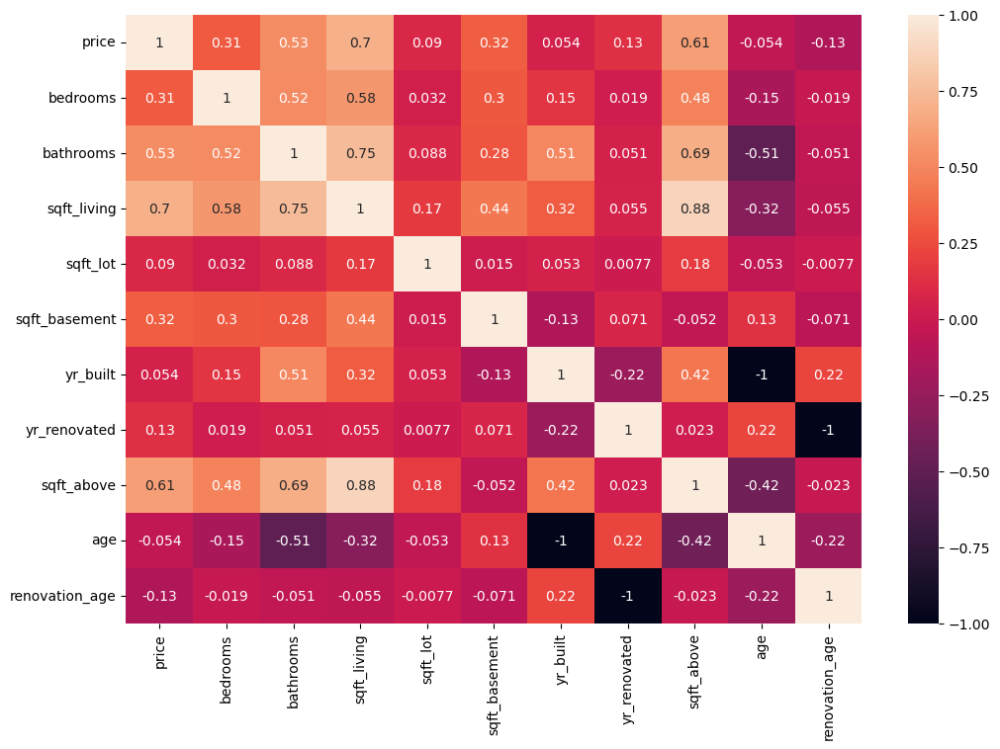

In [12]:
selected_features = [
    'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 
    'sqft_basement', 'yr_built','yr_renovated','sqft_above', 'age', 'renovation_age']

cormap = house_price_df.data[selected_features].corr()

fig5, ax5 = plt.subplots(figsize = (12, 8))

sns.heatmap(cormap, annot = True)
plt.show()

Summarisation of data can be done using Profiling

In [13]:
pip install pandas_profiling

     -------------------------------------- 324.4/324.4 kB 2.0 MB/s eta 0:00:00
     -------------------------------------- 357.5/357.5 kB 2.0 MB/s eta 0:00:00
     -------------------------------------- 102.7/102.7 kB 3.0 MB/s eta 0:00:00
     -------------------------------------- 663.4/663.4 kB 3.5 MB/s eta 0:00:00
     -------------------------------------- 152.1/152.1 kB 3.0 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     -------------------------------------- 296.5/296.5 kB 3.7 MB/s eta 0:00:00
     ---------------------------------------- 4.7/4.7 MB 3.8 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27092 sha256=eec5ef9144f31619d7798bad14738d25608028e739dc57f41d2367a28d7a52f9
  Stored in directory: c:\users\l14\appdata\local\pip\cache\wheels\ea\1c\a8\5cec3479cd45136a7111e2d96aac299b219b199c411665250b
Successfully built htmlmin
Note: you may need to restart the

In [14]:
pip install ipywidgets

Note: you may need to restart the kernel to use updated packages.


### TODO Recording

- Show the Overview
- Scroll and show that we have details for every variable


- Click on Alerts
- Show the text for highly correlated variables
- Scroll below
- In the "Selected Columns" select "price"
- Under Interactions - select "price" on the left and choose "sqft_living", "grade", and "floors" on the right


- Keep scrolling and show "Correlations", "Missing Values" and "Sample"


In [15]:
import ydata_profiling as pp

profile = pp.ProfileReport(house_price_df.data)

profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### TODO Recording

- After saving the file - switch to Jupyter Home (http://localhost:8888)
- Show the file has been saved
- Click on the HTML file and show that you have the entire analysis of your data

In [16]:
profile.to_file("house_price_profile_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

### TODO Recording

- Go to the MLflow UI
- Show that it is still empty
- Come back to the notebook

### MLflow experiment and runs

Creating MLflow experiment

In [17]:
experiment_id = mlflow.create_experiment(name = 'kc_house_price_prediction')

### TODO Recording

- Go to the UI - show that a new experiment can be seen there
- Go to the terminal window in the current working directory (where the notebook is present)
- Run

`ls -l`

- Show that we have a new mlruns/ folder
- Run

`cd mlruns`

`ls -l`

- Show that there is a directory with the experiment ID

We are removing 'sqft_above' as it is having very high corrrelation(0.88) with 'sqft_living'
Remove bathrooms (highly correlated with bedrooms)
Remove sqft_living15 (highly correlated with sqft_living)

Can remove others if you want


In [18]:
house_price_df.data.drop(columns = [
    'yr_built','yr_renovated','sqft_above', 'bathrooms', 'sqft_living15'], inplace = True)

In [19]:
house_price_df.data.shape

(21608, 15)

In [20]:
house_price_df.data.columns

Index(['price', 'bedrooms', 'sqft_living', 'sqft_lot', 'floors', 'waterfront',
       'view', 'condition', 'grade', 'sqft_basement', 'lat', 'long',
       'sqft_lot15', 'age', 'renovation_age'],
      dtype='object')

Creating a features.txt as artifact file

In [21]:
features = """'bedrooms', 'sqft_living', 'sqft_lot', 'floors', 
              'waterfront', 'view', 'condition', 'grade', 
              'sqft_basement', 'lat', 'long', 'sqft_lot15', 
              'age', 'renovation_age'"""

with open("features.txt", "w") as f:
    f.write(features)

If you have checked the mlflow ui, There is one Default experiment with id=0. Get the details of this experiment

In [22]:
experiment = mlflow.get_experiment("0")

print("Name: {}".format(experiment.name))
print("Artifact Location: {}".format(experiment.artifact_location))
print("Tags: {}".format(experiment.tags))
print("Lifecycle_stage: {}".format(experiment.lifecycle_stage))
print("Creation timestamp: {}".format(experiment.creation_time))

Name: Default
Artifact Location: file:///C:/Users/L14/Desktop/mlflow/TrackingExperimentRuns/mlruns/0
Tags: {}
Lifecycle_stage: active
Creation timestamp: 1700726543264


 Note that we can also create experiment through mlfow UI. Here ,We are creating a Mlflow experiment programmatically with name 'kc_house_price_prediction'.

Experiment can also be created by MlflowClientAPI

In [23]:
# from mlflow import MlflowClient
# client = MlflowClient()
# client.create_experiment(name = 'kc_house_price_prediction')

As given in docs, we can obtain experiment related details

In [24]:
experiment = mlflow.get_experiment(experiment_id)

print("Name: {}".format(experiment.name))
print("Experiment_id: {}".format(experiment.experiment_id))
print("Artifact Location: {}".format(experiment.artifact_location))
print("Tags: {}".format(experiment.tags))
print("Lifecycle_stage: {}".format(experiment.lifecycle_stage))
print("Creation timestamp: {}".format(experiment.creation_time))

Name: kc_house_price_prediction
Experiment_id: 352362412866543573
Artifact Location: file:///C:/Users/L14/Desktop/mlflow/TrackingExperimentRuns/mlruns/352362412866543573
Tags: {}
Lifecycle_stage: active
Creation timestamp: 1700726543309


mlflow.get_tracking_uri() returns the current tracking URI.

In [25]:
mlflow.get_tracking_uri()

'file:///C:/Users/L14/Desktop/mlflow/TrackingExperimentRuns/mlruns'

mlflow.set_experiment() sets an experiment as active. If the experiment does not exist, creates a new experiment. If you do not specify an experiment in mlflow.start_run(), new runs are launched under this experiment.

In [26]:
mlflow.set_experiment(experiment_name = 'kc_house_price_prediction')

<Experiment: artifact_location='file:///C:/Users/L14/Desktop/mlflow/TrackingExperimentRuns/mlruns/352362412866543573', creation_time=1700726543309, experiment_id='352362412866543573', last_update_time=1700726543309, lifecycle_stage='active', name='kc_house_price_prediction', tags={}>

mlflow.start_run() returns the currently active run (if one exists), or starts a new run and returns a mlflow.

ActiveRun object usable as a context manager for the current run. You do not need to call start_run explicitly: calling one of the logging functions with no active run automatically starts a new one.

If the argument run_name is not set within mlflow.start_run(), a unique run name will be generated for each run.

In [27]:
mlflow.start_run()
 
mlflow.log_figure(fig1, 'histogram_price.png')
mlflow.log_figure(fig2, 'boxplot_price.png')

### TODO Recording

- Go to the UI and click on the kc_house_price_prediction experiment
- Note there is a new run
- Click on the run and under artifacts you should see the two images that we have logged
- Click on those images and show

If we try to start a new run without ending the previous run, Exception is raised.

In [28]:
mlflow.end_run()

Setting some reasonable name for run and logging additional figures

In [29]:
mlflow.start_run(run_name = 'exploratory_data_analysis')
 
mlflow.log_figure(fig1, 'histogram_price.png')
mlflow.log_figure(fig2, 'boxplot_price.png')
mlflow.log_figure(fig3, 'boxplot_waterfront_vs_price.png')
mlflow.log_figure(fig4, 'regplot_sqft_living_vs_price.png') 
mlflow.log_figure(fig5, 'correlation_heatmap.png') 

mlflow.end_run()

### TODO Recording:

- Go to the experiment, there should be a new run called "exploratory_data_analysis"
- Show that these artifacts are logged under that run

Loading feature names as artifact

In [30]:
mlflow.start_run(run_name = 'features_as_artifacts')

mlflow.log_artifact("features.txt")

Getting the active run id and also ending the active run

In [31]:
run = mlflow.active_run()
 
print('Active run_id: {}'.format(run.info.run_id))
 
mlflow.end_run()

Active run_id: 847420e27d0747418503501f67d31adb


### TODO Recording:

- Go to the UI
- Show yet another run called "features_as_artifacts"
- Click on the run and show the text file is logged as part of that run
- Note the run ID

The run remains open throughout the with statement, and is automatically closed when the statement exits, even if it exits due to an exception.


In [32]:
with mlflow.start_run(run_name = 'eda_plots_and_features_as_artifacts') as current_run:

    mlflow.log_figure(fig1, 'histogram_price.png')
    mlflow.log_figure(fig2, 'boxplot_price.png')
    mlflow.log_figure(fig3, 'boxplot_waterfront_vs_price.png')
    mlflow.log_figure(fig4, 'regplot_sqft_living_vs_price.png') 
    mlflow.log_figure(fig5, 'correlation_heatmap.png') 
    
    mlflow.log_artifact("features.txt")

In [33]:
mlflow.last_active_run()

<Run: data=<RunData: metrics={}, params={}, tags={'mlflow.runName': 'eda_plots_and_features_as_artifacts',
 'mlflow.source.name': 'C:\\Users\\L14\\anaconda3\\lib\\site-packages\\ipykernel_launcher.py',
 'mlflow.source.type': 'LOCAL',
 'mlflow.user': 'L14'}>, info=<RunInfo: artifact_uri='file:///C:/Users/L14/Desktop/mlflow/TrackingExperimentRuns/mlruns/352362412866543573/8333a8a4739345c8aed7f36b180e6f26/artifacts', end_time=1700726732534, experiment_id='352362412866543573', lifecycle_stage='active', run_id='8333a8a4739345c8aed7f36b180e6f26', run_name='eda_plots_and_features_as_artifacts', run_uuid='8333a8a4739345c8aed7f36b180e6f26', start_time=1700726731023, status='FINISHED', user_id='L14'>, inputs=<RunInputs: dataset_inputs=[]>>

In [34]:
client = mlflow.MlflowClient()
data = client.get_run(current_run.info.run_id).data

data

<RunData: metrics={}, params={}, tags={'mlflow.runName': 'eda_plots_and_features_as_artifacts',
 'mlflow.source.name': 'C:\\Users\\L14\\anaconda3\\lib\\site-packages\\ipykernel_launcher.py',
 'mlflow.source.type': 'LOCAL',
 'mlflow.user': 'L14'}>

### TODO Recording

- Go to the UI
- We now have 4 runs within the experiment
- Click on the latest one "eda_plots_and_features_as_artifacts"
- Show this has plots and the text file

List of experiments are obtained

In [35]:
experiments = mlflow.search_experiments()

experiments 

[<Experiment: artifact_location='file:///C:/Users/L14/Desktop/mlflow/TrackingExperimentRuns/mlruns/352362412866543573', creation_time=1700726543309, experiment_id='352362412866543573', last_update_time=1700726543309, lifecycle_stage='active', name='kc_house_price_prediction', tags={}>,
 <Experiment: artifact_location='file:///C:/Users/L14/Desktop/mlflow/TrackingExperimentRuns/mlruns/0', creation_time=1700726543264, experiment_id='0', last_update_time=1700726543264, lifecycle_stage='active', name='Default', tags={}>]

### Logging metrics during model training and evaluation

We can log each metric individually.After completion of 'Simple Linear Regression' run, we can see that only metrics are logged

In [36]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score


with mlflow.start_run(run_name = 'Simple Linear Regression') as lr_run:

    X = house_price_df.data.drop(columns = ['price'])
    y = house_price_df.data['price']
    
    X_sqft_living = X['sqft_living']
    
    X_train, X_test, y_train, y_test = train_test_split(
        X_sqft_living , y, test_size = 0.3, random_state = 123)

    lr_model = LinearRegression()
    lr_model.fit(X_train.to_numpy().reshape(-1, 1), y_train)
    
    y_pred = lr_model.predict(X_test.to_numpy().reshape(-1, 1))
    
    # Training and test metrics
    training_score = lr_model.score(X_train.to_numpy().reshape(-1, 1), y_train)
    mean_abs_error = mean_absolute_error(y_test, y_pred)
    root_mean_sq_error = mean_squared_error(y_test, y_pred, squared = False)
    test_score = r2_score(y_test, y_pred)
   
    # Log model metrics
    mlflow.log_metric('Train_R2_score', training_score)
    mlflow.log_metric('Test_R2_score', test_score)
    mlflow.log_metric('Test_MAE', mean_abs_error)
    mlflow.log_metric('Test_RMSE', root_mean_sq_error)

    mlflow.set_tag('Regressor', 'Simple Linear Regression Model')

### TODO Recording:

- Go to the UI, new run called "Simple Linear Regression"
- Click through and show that the run has metrics and a tag (no artifacts, nothing else)

We can also view Model parameters and metrics using client api

In [37]:
client = mlflow.tracking.MlflowClient()
 
print('Model Parameters', client.get_run(lr_run.info.run_id).data.params)
 
print('Metrics', client.get_run(lr_run.info.run_id).data.metrics)

Model Parameters {}
Metrics {'Test_MAE': 174998.84435471712, 'Test_R2_score': 0.4950098469357981, 'Test_RMSE': 269918.6181424103, 'Train_R2_score': 0.49166868058638125}


We can also log parameters of model individually but we are logging both parameters and metrics together. We can also set tags 

In [38]:
with mlflow.start_run(run_name = 'Multiple Linear Regression') as mlr_run:

    # Log artifacts for EDA and features
    mlflow.log_figure(fig5, 'correlation_heatmap.png') 
    mlflow.log_artifact("features.txt")
    
    X = house_price_df.data.drop(columns = ['price'])
    y = house_price_df.data['price']
    
    X_train, X_test, y_train, y_test = \
        train_test_split(X , y, test_size = 0.3, random_state = 123)
    
    lr_model = LinearRegression()
    
    lr_model.fit(X_train, y_train)
    
    y_pred = lr_model.predict(X_test)
    
    # Metrics
    training_score = lr_model.score(X_train,y_train)
    mean_abs_error = mean_absolute_error(y_test, y_pred)
    root_mean_sq_error = mean_squared_error(y_test, y_pred, squared = False)
    test_score = r2_score(y_test, y_pred)
    
    # Log params    
    params_reg = lr_model.get_params()
    mlflow.log_params(params_reg)
    
    # Log metrics as dictionary
    metrics = {
        'Train_R2_score': training_score, 
        'Test_R2_score': test_score,
        'Test_MAE': mean_abs_error, 
        'Test_RMSE': root_mean_sq_error 
    }
    mlflow.log_metrics(metrics)
    
    mlflow.set_tag('Regressor', 'Multiple Linear Regression Model')
    
    print('Model Parameters', client.get_run(mlr_run.info.run_id).data.params)
    print('Metrics', client.get_run(mlr_run.info.run_id).data.metrics)

Model Parameters {'copy_X': 'True', 'fit_intercept': 'True', 'n_jobs': 'None', 'positive': 'False'}
Metrics {'Test_MAE': 129193.79215236753, 'Test_R2_score': 0.6706317206942913, 'Test_RMSE': 217987.84220380857, 'Train_R2_score': 0.7014489032098927}


### TODO Recording:

- Go to the UI and see the run "Multiple Linear Regression Model"
- Click through and show that the run has logged artifacts, parameters, metrics, and tags

Here we are applying polynomial regression model which includes interactions between features. Here we are logging only degree of polynomial as parameter

In [39]:
from sklearn.preprocessing import PolynomialFeatures

with mlflow.start_run(run_name = 'Polynomial Regression') as pr_run:
    
    degree = 2
    
    # Create polynomial features
    poly = PolynomialFeatures(degree = degree)
    
    poly_features_train = poly.fit_transform(X_train)
    poly_features_test = poly.transform(X_test)
    
    polylr_model = LinearRegression()
    
    polylr_model.fit(poly_features_train, y_train)
    y_pred = polylr_model.predict(poly_features_test)
    
    # Metrics
    training_score = polylr_model.score(poly_features_train,y_train)
    mean_abs_error = mean_absolute_error(y_test, y_pred)
    root_mean_sq_error = mean_squared_error(y_test, y_pred, squared = False)
    test_score = r2_score(y_test, y_pred)
    
    # Log params
    mlflow.log_param('Degree of polynomial', degree)
    
    # Log metrics
    metrics = {
        'Train_R2_score': training_score, 
        'Test_R2_score': test_score,
        'Test_MAE': mean_abs_error, 
        'Test_RMSE': root_mean_sq_error 
    }
    mlflow.log_metrics(metrics)

    mlflow.set_tag('Regressor', 'Polynomial Regression Model with degree 2')
    
    print('Model Parameters', client.get_run(pr_run.info.run_id).data.params)
    print('Metrics', client.get_run(pr_run.info.run_id).data.metrics)

Model Parameters {'Degree of polynomial': '2'}
Metrics {'Test_MAE': 109090.76409066423, 'Test_R2_score': 0.7764606731633992, 'Test_RMSE': 179584.29594084035, 'Train_R2_score': 0.8053931714808884}


### TODO Recording:

- Go to the UI
- Click on the new polynomial regression run
- Show everything that we have logged

In [40]:
from sklearn.ensemble import RandomForestRegressor

with mlflow.start_run(run_name = 'Random Forest Regression default params') as rf_run:
   
    rf_model = RandomForestRegressor()
    
    rf_model .fit(X_train, y_train)
    y_pred = rf_model.predict(X_test)
    
    training_score = rf_model.score(X_train,y_train)
    mean_abs_error = mean_absolute_error(y_test, y_pred)
    root_mean_sq_error = mean_squared_error(y_test, y_pred, squared = False)
    test_score = r2_score(y_test, y_pred)

    # Log params
    params_reg = rf_model.get_params()
    mlflow.log_params(params_reg)

    # Log metrics
    metrics = {
        'Train_R2_score': training_score, 
        'Test_R2_score': test_score,
        'Test_MAE': mean_abs_error, 
        'Test_RMSE': root_mean_sq_error
    }
    mlflow.log_metrics(metrics)
    
    mlflow.set_tag('Regressor', 'RF default parameters')
    
    print('Model Parameters', client.get_run(rf_run.info.run_id).data.params)
    print('Metrics', client.get_run(rf_run.info.run_id).data.metrics)

Model Parameters {'bootstrap': 'True', 'ccp_alpha': '0.0', 'criterion': 'squared_error', 'max_depth': 'None', 'max_features': '1.0', 'max_leaf_nodes': 'None', 'max_samples': 'None', 'min_impurity_decrease': '0.0', 'min_samples_leaf': '1', 'min_samples_split': '2', 'min_weight_fraction_leaf': '0.0', 'n_estimators': '100', 'n_jobs': 'None', 'oob_score': 'False', 'random_state': 'None', 'verbose': '0', 'warm_start': 'False'}
Metrics {'Test_MAE': 71486.93605491162, 'Test_R2_score': 0.8670143338254096, 'Test_RMSE': 138514.04228406775, 'Train_R2_score': 0.9822939813390923}


### TODO Recording:

- Go to the UI
- Click on the new random forest with default params run
- Show everything that we have logged

We can also manually tune parameters and log only the tuned parameters

In [41]:
with mlflow.start_run(run_name = 'Random Forest Regression tuned params') as rft_run:

    n_estimators = 200
    max_depth = 10
    min_samples_split = 5
    min_samples_leaf = 2
   
    rf_model = RandomForestRegressor(
        n_estimators = n_estimators, 
        max_depth = max_depth,
        min_samples_split = min_samples_split, 
        min_samples_leaf = min_samples_leaf)

    rf_model.fit(X_train, y_train)
    y_pred = rf_model.predict(X_test)
    
    training_score = rf_model.score(X_train,y_train)
    mean_abs_error = mean_absolute_error(y_test, y_pred)
    root_mean_sq_error = mean_squared_error(y_test, y_pred, squared = False)
    test_score = r2_score(y_test, y_pred)

    # Log params
    params = {
        'n_estimators': n_estimators, 
        'max_depth': max_depth,
        'min_samples_split': min_samples_split, 
        'min_samples_leaf': min_samples_leaf
    }
    mlflow.log_params(params)
    
    # Log metrics
    metrics = {
        'Train_R2_score': training_score, 
        'Test_R2_score': test_score,
        'Test_MAE': mean_abs_error, 
        'Test_RMSE': root_mean_sq_error
    }
    mlflow.log_metrics(metrics)
    
    mlflow.set_tag('Regressor', 'RF tuned parameters')

### TODO Recording:

- Go to the UI
- Click on the new random forest with tuned params run
- Show everything that we have logged0

##### All runs in the experiment

- Now click on the experiment
- On the page click on Columns
- Show there are many columns that you can now include
- Select Test R2 Score and Regressor (under tags)

##### Sorting

- Sort based on Train_R2_score and show
- Sort based on Test_R2_score and show

We can also search for runs using 'search_runs' and also obtain the data in sorted form in dataframe wrt some metric(here it is Test_R2_score). RF model with default parameters seem to have highest R2 score

In [42]:
df_run_metrics = mlflow.search_runs(
    [experiment.experiment_id], order_by = ['metrics.Test_R2_score DESC'])
 
df_run_metrics

,run_id,experiment_id,status,artifact_uri,start_time,end_time,metrics.Train_R2_score,metrics.Test_R2_score,metrics.Test_RMSE,metrics.Test_MAE,...,params.max_features,params.Degree of polynomial,params.positive,params.fit_intercept,params.copy_X,tags.mlflow.source.type,tags.mlflow.runName,tags.mlflow.source.name,tags.mlflow.user,tags.Regressor
0,626dd7adc1084088b6fcadd63b561cb1,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:06:07.330000+00:00,2023-11-23 08:06:44.012000+00:00,0.982294,0.867014,138514.042284,71486.936055,...,1.0,None,None,None,None,LOCAL,Random Forest Regression default params,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,RF default parameters
1,500d5033c1074332aef734d94bd2a509,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:06:44.065000+00:00,2023-11-23 08:07:21.448000+00:00,0.929457,0.853242,145509.992636,77913.752327,...,None,None,None,None,None,LOCAL,Random Forest Regression tuned params,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,RF tuned parameters
2,88b283e3598642c18882db6c65c1d928,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:06:04.525000+00:00,2023-11-23 08:06:04.923000+00:00,0.805393,0.776461,179584.295941,109090.764091,...,None,2,None,None,None,LOCAL,Polynomial Regression,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,Polynomial Regression Model with degree 2
3,76624461d7be4598ac4226801329bed8,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:06:02.192000+00:00,2023-11-23 08:06:02.927000+00:00,0.701449,0.670632,217987.842204,129193.792152,...,None,None,False,True,True,LOCAL,Multiple Linear Regression,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,Multiple Linear Regression Model
4,1b6634f7cef942329df3c09488fe06ee,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:05:54.607000+00:00,2023-11-23 08:05:54.784000+00:00,0.491669,0.495010,269918.618142,174998.844355,...,None,None,None,None,None,LOCAL,Simple Linear Regression,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,Simple Linear Regression Model
5,8333a8a4739345c8aed7f36b180e6f26,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:05:31.023000+00:00,2023-11-23 08:05:32.534000+00:00,NaN,NaN,NaN,NaN,...,None,None,None,None,None,LOCAL,eda_plots_and_features_as_artifacts,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,None
6,847420e27d0747418503501f67d31adb,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:05:23.906000+00:00,2023-11-23 08:05:26.492000+00:00,NaN,NaN,NaN,NaN,...,None,None,None,None,None,LOCAL,features_as_artifacts,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,None
7,532f64f0d95e45e0a0fe1e25c2ff611d,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:05:19.310000+00:00,2023-11-23 08:05:20.889000+00:00,NaN,NaN,NaN,NaN,...,None,None,None,None,None,LOCAL,exploratory_data_analysis,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,None
8,30bd38f6f96d4bbfbf2b3b7bd23959ce,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:03:47.239000+00:00,2023-11-23 08:05:17.144000+00:00,NaN,NaN,NaN,NaN,...,None,None,None,None,None,LOCAL,resilient-perch-150,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,None


Deleting a specific run

In [43]:
run_id_for_delete = df_run_metrics.loc[5, 'run_id']
 
run_id_for_delete

'8333a8a4739345c8aed7f36b180e6f26'

We can easily delete any run using UI. Here we are showing programmatically method of deletion of run

In [44]:
mlflow.delete_run(run_id_for_delete)

Checking the deletion

In [45]:
df_run_metrics = mlflow.search_runs(
    [experiment.experiment_id], order_by = ['metrics.Test_R2_score DESC'])
 
df_run_metrics

,run_id,experiment_id,status,artifact_uri,start_time,end_time,metrics.Train_R2_score,metrics.Test_R2_score,metrics.Test_RMSE,metrics.Test_MAE,...,params.max_features,params.Degree of polynomial,params.positive,params.fit_intercept,params.copy_X,tags.mlflow.source.type,tags.mlflow.runName,tags.mlflow.source.name,tags.mlflow.user,tags.Regressor
0,626dd7adc1084088b6fcadd63b561cb1,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:06:07.330000+00:00,2023-11-23 08:06:44.012000+00:00,0.982294,0.867014,138514.042284,71486.936055,...,1.0,None,None,None,None,LOCAL,Random Forest Regression default params,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,RF default parameters
1,500d5033c1074332aef734d94bd2a509,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:06:44.065000+00:00,2023-11-23 08:07:21.448000+00:00,0.929457,0.853242,145509.992636,77913.752327,...,None,None,None,None,None,LOCAL,Random Forest Regression tuned params,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,RF tuned parameters
2,88b283e3598642c18882db6c65c1d928,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:06:04.525000+00:00,2023-11-23 08:06:04.923000+00:00,0.805393,0.776461,179584.295941,109090.764091,...,None,2,None,None,None,LOCAL,Polynomial Regression,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,Polynomial Regression Model with degree 2
3,76624461d7be4598ac4226801329bed8,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:06:02.192000+00:00,2023-11-23 08:06:02.927000+00:00,0.701449,0.670632,217987.842204,129193.792152,...,None,None,False,True,True,LOCAL,Multiple Linear Regression,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,Multiple Linear Regression Model
4,1b6634f7cef942329df3c09488fe06ee,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:05:54.607000+00:00,2023-11-23 08:05:54.784000+00:00,0.491669,0.495010,269918.618142,174998.844355,...,None,None,None,None,None,LOCAL,Simple Linear Regression,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,Simple Linear Regression Model
5,847420e27d0747418503501f67d31adb,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:05:23.906000+00:00,2023-11-23 08:05:26.492000+00:00,NaN,NaN,NaN,NaN,...,None,None,None,None,None,LOCAL,features_as_artifacts,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,None
6,532f64f0d95e45e0a0fe1e25c2ff611d,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:05:19.310000+00:00,2023-11-23 08:05:20.889000+00:00,NaN,NaN,NaN,NaN,...,None,None,None,None,None,LOCAL,exploratory_data_analysis,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,None
7,30bd38f6f96d4bbfbf2b3b7bd23959ce,352362412866543573,FINISHED,file:///C:/Users/L14/Desktop/mlflow/TrackingEx...,2023-11-23 08:03:47.239000+00:00,2023-11-23 08:05:17.144000+00:00,NaN,NaN,NaN,NaN,...,None,None,None,None,None,LOCAL,resilient-perch-150,C:\Users\L14\anaconda3\lib\site-packages\ipyke...,L14,None


Runs can be searched by using filter string.Only runs with Test R2 score above 0.8 are filtered out

In [46]:
df_run_metrics = mlflow.search_runs(
    [experiment.experiment_id], filter_string = 'metrics.Test_R2_score > 0.8', 
    order_by = ['metrics.Test_R2_score DESC'])
 
df_run_metrics[[
    'run_id', 'metrics.Test_R2_score', 'metrics.Train_R2_score', 'tags.Regressor']]

,run_id,metrics.Test_R2_score,metrics.Train_R2_score,tags.Regressor
0,626dd7adc1084088b6fcadd63b561cb1,0.867014,0.982294,RF default parameters
1,500d5033c1074332aef734d94bd2a509,0.853242,0.929457,RF tuned parameters


Autologging parameters and metrics can also be enabled using calling mlflow.autolog or mlflow.sklearn.autolog

https://mlflow.org/docs/latest/tracking.html#automatic-logging. By going to the specific run page,It can be seen that all regression parameters , training set metrics,tags,artifacts(Model,estimator,metric info) are auto logged

https://learn.microsoft.com/en-gb/azure/databricks/mlflow/databricks-autologging#customize-logging-behavior

### Warning when this code is run

- Does not matter since our data does not have missing values
- Can be fixed by converting our int columns to float so we can deal with missing values (we will do that below)
- Can also fix this by inferring the signature of the model with sample data that has missing values in the int column

In [47]:
mlflow.sklearn.autolog()

with mlflow.start_run(run_name = 'Random Forest Regression tuned params autologged') as rftal_run:

    n_estimators = 200
    max_depth = 10
    min_samples_split = 5
    min_samples_leaf = 2
   
    rf_model = RandomForestRegressor(
        n_estimators = n_estimators, 
        max_depth = max_depth,
        min_samples_split = min_samples_split, 
        min_samples_leaf = min_samples_leaf
    )
    
    rf_model.fit(X_train, y_train)
    y_pred = rf_model.predict(X_test)
    
    training_score = rf_model.score(X_train,y_train)
    
    # Test metrics - these will NOT be autologged (only training metrics will be autologged)
    mean_abs_error = mean_absolute_error(y_test, y_pred)
    root_mean_sq_error = mean_squared_error(y_test, y_pred, squared = False)
    test_score = r2_score(y_test, y_pred)
    
    mlflow.set_tag('Regressor', 'RF tuned parameters with autolog')

2023/11/23 10:07:24 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "C:\Users\L14\anaconda3\lib\site-packages\mlflow\data\pandas_dataset.py:134: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2023/11/23 10:08:02 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "C:\Users\L14\anaconda3\lib\site-packages\mlflow\m

### TODO Recording

- Go to the UI - make sure you sort by the "Created" column in the descending order so the latest run is on top
- Click on the run and show that everything has been logged by default
- Open up each section and show

##### Artifacts

- Under Artifacts click on the model/ folder
- Show that we now have a serialized version of the trained model as an artificact. This can now be registered with the model registry and deployed for predictions
- Click on each file under the model/ folder and show

Explanations for each file here: https://www.mlflow.org/docs/latest/models.html

In [48]:
house_price_df.data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21608 entries, 0 to 21612
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   price           21608 non-null  float64
 1   bedrooms        21608 non-null  int64  
 2   sqft_living     21608 non-null  int64  
 3   sqft_lot        21608 non-null  int64  
 4   floors          21608 non-null  float64
 5   waterfront      21608 non-null  int64  
 6   view            21608 non-null  int64  
 7   condition       21608 non-null  int64  
 8   grade           21608 non-null  int64  
 9   sqft_basement   21608 non-null  int64  
 10  lat             21608 non-null  float64
 11  long            21608 non-null  float64
 12  sqft_lot15      21608 non-null  int64  
 13  age             21608 non-null  int64  
 14  renovation_age  21608 non-null  int64  
dtypes: float64(4), int64(11)
memory usage: 3.1 MB


In [49]:
house_price_df.data.columns

Index(['price', 'bedrooms', 'sqft_living', 'sqft_lot', 'floors', 'waterfront',
       'view', 'condition', 'grade', 'sqft_basement', 'lat', 'long',
       'sqft_lot15', 'age', 'renovation_age'],
      dtype='object')

In [50]:
int_columns = [
    'bedrooms', 'sqft_living', 'sqft_lot', 'waterfront',
    'view', 'condition', 'grade', 'sqft_basement', 'lat', 'long',
    'sqft_lot15', 'age', 'renovation_age'
]

for col in int_columns:
    house_price_df.data[col] = house_price_df.data[col].astype(float)

house_price_df.data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21608 entries, 0 to 21612
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   price           21608 non-null  float64
 1   bedrooms        21608 non-null  float64
 2   sqft_living     21608 non-null  float64
 3   sqft_lot        21608 non-null  float64
 4   floors          21608 non-null  float64
 5   waterfront      21608 non-null  float64
 6   view            21608 non-null  float64
 7   condition       21608 non-null  float64
 8   grade           21608 non-null  float64
 9   sqft_basement   21608 non-null  float64
 10  lat             21608 non-null  float64
 11  long            21608 non-null  float64
 12  sqft_lot15      21608 non-null  float64
 13  age             21608 non-null  float64
 14  renovation_age  21608 non-null  float64
dtypes: float64(15)
memory usage: 3.1 MB


To log post training metrics, Autologging must be enabled before scikit-learn metric APIs are imported from sklearn.metrics. Metric APIs imported before autologging is enabled do not log metrics to MLflow runs.

Note that the warning has disappeared since we treat all numeric columns as floats

In [51]:
mlflow.sklearn.autolog()

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

with mlflow.start_run(run_name = 'Random Forest Regression tuned params and metrics autologged'):

    # Training and test data with integers converted to floats
    X = house_price_df.data.drop(columns = ['price'])
    y = house_price_df.data['price']
    
    X_train, X_test, y_train, y_test = \
        train_test_split(X , y, test_size = 0.3, random_state = 123)

    n_estimators = 200
    max_depth = 10
    min_samples_split = 5
    min_samples_leaf = 2
   
    rf_model = RandomForestRegressor(
        n_estimators = n_estimators, 
        max_depth = max_depth,
        min_samples_split = min_samples_split, 
        min_samples_leaf = min_samples_leaf
    )
    
    rf_model.fit(X_train, y_train)
    y_pred = rf_model.predict(X_test)
    
    mean_abs_error = mean_absolute_error(y_test, y_pred)
    root_mean_sq_error = mean_squared_error(y_test, y_pred, squared = False)
    test_score = r2_score(y_test, y_pred)
    
    mlflow.set_tag('Regressor', 'RF tuned parameters and autologged metrics')

### TODO Recording

- Go to the UI and show the run
- Click through to the run and open up the "Metrics" section and show that the test metrics that we computed were autologged

### TODO Recording comparing runs

#### Linear regression runs
- In the MLflow UI
- Click on the experiment and show all the runs
- Select Multiple Linear Regression and Polynomial Regression and click on Compare
- In the Parallel Coordinates chart choose 
- ---- Parameters - degree of polynomial, Metrics - Test R2 score
- ---- Add another metric - Train R2 score

- Scroll and show the other differences between the runs
- Click on "diff only"


#### Random forest runs

- Go to experiment and see all runs
- Select Default RF and Tuned RF and click on Compare
- In the Parallel Coordinates chart choose 
- ---- Parameters - n_estimators, max_dept, 
- ----- Metrics - Test R2 score, Train R2 score
- Click on Scatter Plot
- ----- Choose n_estimators on X-axis
- ----- Choose Test_MAE on Y-axis

- Scroll and show the other differences